## Exercise 1 - **Advection-Diffusion**

The goal of this exercise is to couple physical processes implementing:
- 1D advection-diffusion
- Non-dimensional numbers

The goal of this exercise is to combine advection and diffusion processes acting on the concentration of a quantity $C$.

From what you learned in class, write an advection-diffusion code having following physical input parameters:

```julia
# Physics
lx   = 20.0  # domain length
dc   = 0.1   # diffusion coefficient
vx   = 1.0   # advection velocity
ttot = 20.0  # total simulation time
```

Discretise your domain in 200 finite-difference cells such that the first cell centre is located at `dx/2` and the last cell centre at `lx-dx/2`. Use following explicit time step limiters:

```julia
dta  = dx/abs(vx)
dtd  = dx^2/dc/2
dt   = min(dtd, dta)
```

As initial condition, define a Gaussian profile of concentration `C` of amplitude and standard deviation equal to 1, located at `lx/4`.

In the time-loop, add a condition that would change de direction of the velocity `vx` at time `ttot/2`.

Keep the concentration at the boundaries at `C=0`.

> 💡 hint: Don't forget to initialise (pre-allocate) all arrays (vectors) needed in the calculations.

### Question 1

Report the initial and final distribution of concentration on a figure with axis-label, title, and plotted line labels. Also, report on the figure (as text in one label of your choice) the maximal final concentration value and its x location.

### Question 2

Repeat the exercise but introduce the non-dimensional [Péclet number](https://en.wikipedia.org/wiki/Péclet_number) $Pe = lx~vx/dc$ as physical quantity defining the diffusion coefficient `dc` as a `# Derived physics` quantity. Confirm the if $Pe >> 100$ the diffusion happens in a much longer time compared to the advection, and the opposite for $Pe << 100$.

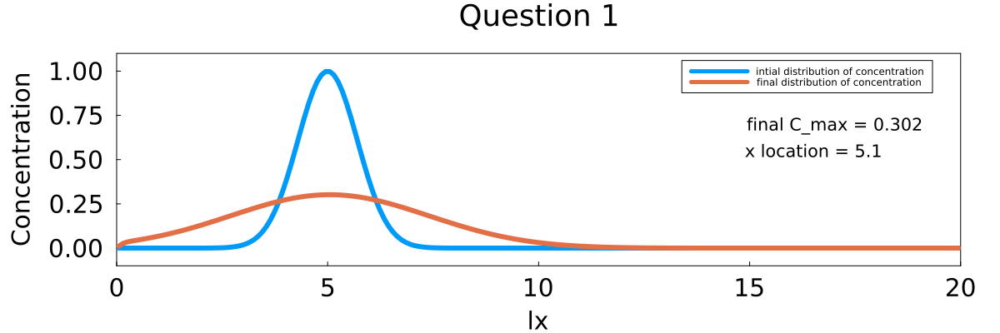

In [15]:
#Task 1 new
using Plots, Plots.Measures,Printf
default(size=(1200,400),framestyle=:box,label=false,grid=false,margin=10mm,lw=6,labelfontsize=20,tickfontsize=20,titlefontsize=24)

function diffusion_advection()
    #physics
    lx   = 20.0 #domain length
    dc   = 0.1  #diffusion coefficient
    vx   = 1.0  #advection velocity
    ttot = 20.0 #total simulation time

    #numerics
    nx   = 200 #number of grid cells to discretise the computational domain

    #derived numerics
    dx   = lx / nx
    xc   = LinRange(dx / 2, lx - dx / 2, nx) #Linrange(coordinate of first point, last point, discretisation)
    dta  = dx/abs(vx) 
    dtd  = dx^2/dc/2
    dt   = min(dta, dtd)

    location  = lx/4 
    stddev    = 1
    amplitude = 1 #1/stddev*sqrt(2*pi)

    #array initialisation

    C    = @. amplitude * exp(- ((xc - location / stddev)^2))
    C_i  = copy(C)
    qx   = zeros(nx-1)

    #time loop
    nt   = ttot/dt
    t    = 0
    nvis = 100
    
    for it in 1:nt

        qx         = .-dc .* diff(C)  ./ dx
        C[2:end-1] .-=  dt .* diff(qx) ./ dx
        C[1]        = 0
        C[end]      = 0 
            
        if t > ttot/2
            vx = -1
            C[1:end-1]   .-=  dt  .* diff(C) ./ dx .* vx
                
        else
    
            C[2:end]   .-=  dt  .* diff(C) ./ dx .* vx
            
        end
        t += dt
    end

    C_max, index_max = findmax(C) #return max value of distribution and its index 

    plot(xc,[C_i,C];xlims=(0,lx), ylims=(-0.1,1.1), xlabel="lx", ylabel="Concentration",title="Question 1", label = ["intial distribution of concentration" "final distribution of concentration"])
    annotate!(17, 0.7, "final C_max = $(round(C_max,digits=3))")
    annotate!(16.5, 0.55, "x location = $(round(index_max*dx,digits=2))")
end

diffusion_advection()

┌ Info: Saved animation to /home/jovyan/assignments/homework 2 - Sarangi Ganeshalingam/tmp.gif
└ @ Plots /opt/julia/packages/Plots/sxUvK/src/animation.jl:156


Plots.AnimatedGif("/home/jovyan/assignments/homework 2 - Sarangi Ganeshalingam/tmp.gif")
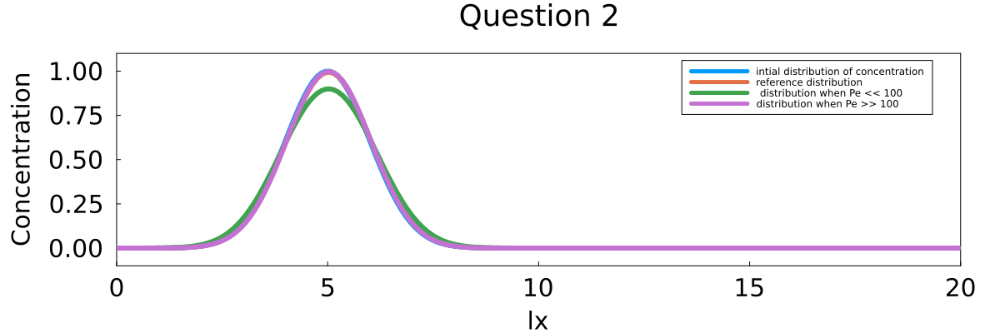

In [1]:
#Task 2 new
using Plots, Plots.Measures,Printf
default(size=(1200,400),framestyle=:box,label=false,grid=false,margin=10mm,lw=6,labelfontsize=20,tickfontsize=20,titlefontsize=24)

function diffusion_advection()
    #physics
    lx   = 20.0 
    vx   = 1.0  
    ttot = 20.0 

    #numerics
    nx   = 200 

    #derived numerics
    #here different Pe values are initialised and different dc values are calculated
    ## Pe ref
    Pe   = 100
    dc   = lx * vx / Pe 
    ## Pe << 100
    Pe1  = 70
    dc_Pe1  = lx * vx / Pe1
    ## Pe >> 100
    Pe2  = 1000   #for Pe >> 100
    dc_Pe2  = lx * vx / Pe2
    
    dx   = lx / nx
    xc   = LinRange(dx / 2, lx - dx / 2, nx) 
    dta  = dx/abs(vx) 
    dtd  = dx^2/dc/2
    dt   = min(dta, dtd)

    location, stddev, amplitude = lx/4 , 1, 1

    #array initialisation

    C      = @. amplitude * exp(-0.5 * ((xc - location / stddev)^2))
    C_i    = copy(C)
    C_Pe1  = copy(C) #different array for Pe1 -> Pe<<100
    C_Pe2  = copy(C) #different array for Pe2 -> Pe>>100
    qx     = zeros(nx-1)
    qx_Pe1 = copy(qx)
    qx_Pe2 = copy(qx)

    #time loop
    nt   = ttot/dt
    t    = 0
    nvis = 100
    
    @gif for it in 1:nt

             qx         = .-dc     .* diff(C)      ./ dx
             qx_Pe1     = .-dc_Pe1 .* diff(C_Pe1)  ./ dx
             qx_Pe2     = .-dc_Pe2 .* diff(C_Pe2)  ./ dx
      
             C[2:end-1]     .-=  dt .* diff(qx)     ./ dx
             C_Pe1[2:end-1] .-=  dt .* diff(qx_Pe1) ./ dx
             C_Pe2[2:end-1] .-=  dt .* diff(qx_Pe2) ./ dx
             C[1], C_Pe1[1], C_Pe2[1]            = 0, 0, 0
             C[end], C_Pe1[end], C_Pe2[end]      = 0, 0, 0 
    
             if t > ttot/2
                 vx = -1
                 C[1:end-1]       .-=  dt  .* diff(C)     ./ dx .* vx
                 C_Pe1[1:end-1]   .-=  dt  .* diff(C_Pe1) ./ dx .* vx
                 C_Pe2[1:end-1]   .-=  dt  .* diff(C_Pe2) ./ dx .* vx    
             else
                 vx = 1
                 C[2:end]       .-=  dt  .* diff(C)     ./ dx .* vx
                 C_Pe1[2:end]   .-=  dt  .* diff(C_Pe1) ./ dx .* vx
                 C_Pe2[2:end]   .-=  dt  .* diff(C_Pe2) ./ dx .* vx
             end
             t += dt
             C_max = 1
             plot(xc,[C_i,C, C_Pe1, C_Pe2];xlims=(0,lx), ylims=(-0.1,1.1), xlabel="lx", ylabel="Concentration",title="Question 2", label = ["intial distribution of concentration" "reference distribution" " distribution when Pe << 100 " "distribution when Pe >> 100"])
         
         end

    
    
    
end

diffusion_advection()
